In [1]:
import pyreadr
import pandas as pd
import numpy as np
import altair_ally as aly
import altair as alt
import missingno as msno
import miceforest as mf
import matplotlib.pyplot as plt
import seaborn as sns

alt.data_transformers.enable('vegafusion')

DataTransformerRegistry.enable('vegafusion')

In [3]:
df_train = pd.read_parquet('./data/train_data.parquet')
feature_cols = ['NDVI', 'SAVI', 'MSAVI', 'EVI','EVI2', 'NDWI', 'NBR', 'TCB', 'TCG', 'TCW']

target_cols = ['SrvvR_1', 'SrvvR_2', 'SrvvR_3', 'SrvvR_4','SrvvR_5', 'SrvvR_6', 'SrvvR_7']

drop_cols = ['ID', 'PixelID', 'Area_ha', 'Season', 'PlantDt', 'prevUse', 'Planted','SpcsCmp', 'Type',
            'NmbrPlO', 'NmbrPlR', 'NmbrPlT', 'ImgDate',]

# Loading/Splitting Data

## Loading RDS Data

In [6]:
#!pip install pyarrow
#!pip install pyreadr
#!pip install altair 
#!pip install altair-ally
#!pip install "vegafusion[embed]>=1.5.0"
#!pip install "vl-convert-python>=1.6.0"
#!pip install missingno
#!pip install miceforest

In [3]:
df = pyreadr.read_r('./data/AfforestationAssessmentDataUBCCapstone.rds')
df = df[None]

In [7]:
df.head()

,ID,PixelID,Area_ha,Season,PlantDt,prevUse,Planted,SpcsCmp,Type,SrvvR_1,...,NDVI,SAVI,MSAVI,EVI,EVI2,NDWI,NBR,TCB,TCG,TCW
0,1,4988855_49599159,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.883094,0.667642,0.633050,0.756227,0.714064,0.439663,0.703400,0.415085,0.311114,0.017062
1,1,4989153_49599156,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.879094,0.655741,0.617071,0.740917,0.698194,0.446987,0.706887,0.401745,0.301618,0.019620
2,1,4989451_49599159,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.868095,0.635130,0.586011,0.707415,0.671987,0.426464,0.687346,0.392422,0.285877,0.011346
3,1,4988857_49598858,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.881818,0.650610,0.614241,0.731699,0.690243,0.449857,0.705937,0.392378,0.296208,0.019493
4,1,4989152_49598854,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.875917,0.641541,0.599425,0.724088,0.679006,0.453866,0.707038,0.385739,0.289788,0.021147


## Splitting into Training Data by Site ID

In [20]:
# a list of all site IDs`
id_list = np.arange(df['ID'].min(),df['ID'].max()+1)

NameError: name 'df' is not defined

In [21]:
# initialize split parameters
SEED = 591
prop_train = 0.7
n_training_sites = int(prop_train*len(ID_list))
np.random.seed(SEED)

NameError: name 'ID_list' is not defined

In [58]:
# randomly select proportion of sites for training set
training_ids = np.random.choice(id_list,size=n_training_sites,replace=False)

In [59]:
df_train = df[df['ID'].isin(training_ids)]

In [61]:
df_train.head()

,ID,PixelID,Area_ha,Season,PlantDt,prevUse,Planted,SpcsCmp,Type,SrvvR_1,...,NDVI,SAVI,MSAVI,EVI,EVI2,NDWI,NBR,TCB,TCG,TCW
0,1,4988855_49599159,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.883094,0.667642,0.633050,0.756227,0.714064,0.439663,0.703400,0.415085,0.311114,0.017062
1,1,4989153_49599156,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.879094,0.655741,0.617071,0.740917,0.698194,0.446987,0.706887,0.401745,0.301618,0.019620
2,1,4989451_49599159,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.868095,0.635130,0.586011,0.707415,0.671987,0.426464,0.687346,0.392422,0.285877,0.011346
3,1,4988857_49598858,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.881818,0.650610,0.614241,0.731699,0.690243,0.449857,0.705937,0.392378,0.296208,0.019493
4,1,4989152_49598854,1.460085,2008.0,None,AG,2400.0,"HW 25,SW 75",NaN,96.9,...,0.875917,0.641541,0.599425,0.724088,0.679006,0.453866,0.707038,0.385739,0.289788,0.021147


## Save Training Data to Parquet

In [1]:
df_train.to_parquet('./data/train_data.parquet')

NameError: name 'df_train' is not defined

# Exploratory Data Analysis

## Pairwise Correlation Plot of VIs and Target

In [2]:
df_train = pd.read_parquet('./data/train_data.parquet')

In [7]:
# do some cleaning to get columns of interest, remove rows with all null features

feature_cols = ['NDVI', 'SAVI', 'MSAVI', 'EVI','EVI2', 'NDWI', 'NBR', 'TCB', 'TCG', 'TCW']

target_cols = ['SrvvR_1', 'SrvvR_2', 'SrvvR_3', 'SrvvR_4','SrvvR_5', 'SrvvR_6', 'SrvvR_7']

drop_cols = ['ID', 'PixelID', 'Area_ha', 'Season', 'PlantDt', 'prevUse', 'Planted','SpcsCmp', 'Type',
            'NmbrPlO', 'NmbrPlR', 'NmbrPlT', 'ImgDate',]

In [9]:
df_train[target_cols + feature_cols].head()

,SrvvR_1,SrvvR_2,SrvvR_3,SrvvR_4,SrvvR_5,SrvvR_6,SrvvR_7,NDVI,SAVI,MSAVI,EVI,EVI2,NDWI,NBR,TCB,TCG,TCW
0,96.9,87.1,NaN,NaN,82.1,NaN,NaN,0.883094,0.667642,0.633050,0.756227,0.714064,0.439663,0.703400,0.415085,0.311114,0.017062
1,96.9,87.1,NaN,NaN,82.1,NaN,NaN,0.879094,0.655741,0.617071,0.740917,0.698194,0.446987,0.706887,0.401745,0.301618,0.019620
2,96.9,87.1,NaN,NaN,82.1,NaN,NaN,0.868095,0.635130,0.586011,0.707415,0.671987,0.426464,0.687346,0.392422,0.285877,0.011346
3,96.9,87.1,NaN,NaN,82.1,NaN,NaN,0.881818,0.650610,0.614241,0.731699,0.690243,0.449857,0.705937,0.392378,0.296208,0.019493
4,96.9,87.1,NaN,NaN,82.1,NaN,NaN,0.875917,0.641541,0.599425,0.724088,0.679006,0.453866,0.707038,0.385739,0.289788,0.021147


In [42]:
# plotting correlation between vegetation indices and target survival rates
corr_chart = aly.corr(
    df_train[feature_cols + target_cols],  
).properties(
     title = 'VI and Survival Rate Correlations'
)

corr_chart

alt.ConcatChart(...)

In [46]:
corr_chart.save('./img/feat_target_correlation.png',ppi=300)

## Exploring Missingness Patterns


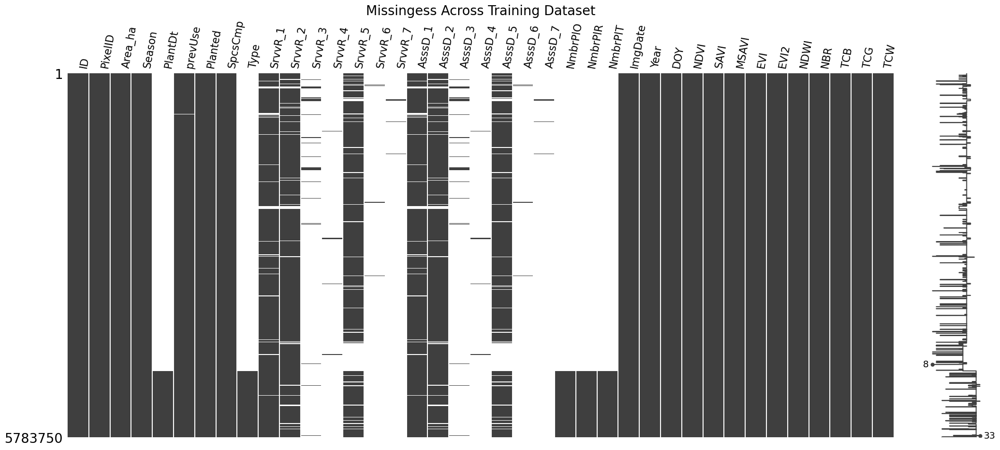

In [40]:
msno.matrix(df_train,label_rotation=80)
plt.title('Missingess Across Training Dataset',fontsize=20)
plt.savefig('./img/missing_rows.png',dpi=300,bbox_inches='tight')

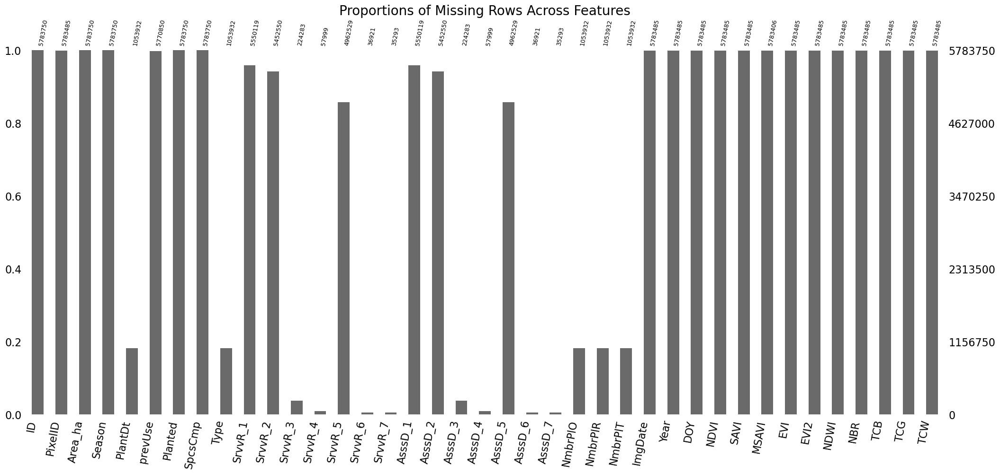

In [37]:
msno.bar(df_train,label_rotation=80)
plt.title('Proportions of Missing Rows Across Features',fontsize=20)
plt.xticks(fontsize=9)
plt.savefig('./img/missing_proportions.png',dpi=300,bbox_inches='tight')

## Missingness Correlation

A value near -1 means if one variable appears then the other variable is very likely to be missing.

A value near 0 means there is no dependence between the occurrence of missing values of two variables.

A value near 1 means if one variable appears then the other variable is very likely to be present.

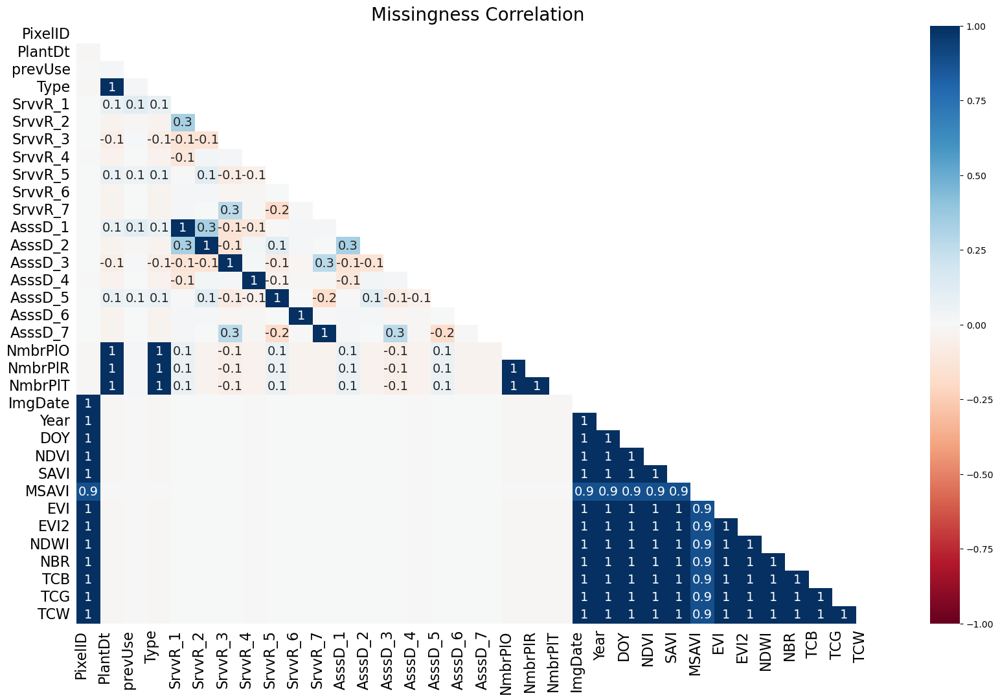

In [26]:
msno.heatmap(df_train,label_rotation=90)
plt.title('Missingness Correlation',fontsize=20)
plt.savefig("./img/missing_correlation.png", dpi=300, bbox_inches='tight')

## More Numeric Feature/Target Exploration

### Distribution of Survival Rates

In [3]:
train_targets_long = df_train[target_cols].melt().rename(
    columns = {'variable':'survey',
              'value':'survival_rate'}
).dropna()

There are records with a survival rate above 100%, but only in the first year of records.

In [8]:
target_dists = alt.Chart(
    train_targets_long[train_targets_long['survival_rate'] <= 100]
).mark_bar().encode(
    x = alt.X(
        'survival_rate',
        title = 'Survival Rate (%)',
        bin = alt.Bin(maxbins=30)
    ),
    y = alt.Y(
        'count()',
        title = 'Count'
    ),              
).facet(
    facet=alt.Facet('survey:N',title = None),
    columns=3
).properties(
    title = 'Distribution of Survival Rate Across Survey Years',
).configure_facet(
    spacing=5 
).configure_title(
    fontSize=16,
    anchor='middle'
)

target_dists

alt.FacetChart(...)

### Boxplots of Survival Rates

In [5]:
target_boxplots = alt.Chart(
    train_targets_long.query('survival_rate <=100')
).mark_boxplot().encode(
    x = alt.X(
        'survival_rate:Q',
        title = 'Survival Rate (%)',
    ),
    y = alt.Y(
        'survey:N',
        title = 'Survey'
    ),
    color = alt.Color('survey',title = None).legend(None)
).properties(
    title = 'Distribution of Survival Rate Across Survey Years',
    width=800,
    height=300
)
target_boxplots

alt.Chart(...)

In [6]:
target_boxplots.save('./img/target_boxplots.png',ppi=300)

### Visualizing Outliers in Survival Rate (>100%)

In [26]:
# plot first survey without filtering < 100% 

first_year_target_dist = alt.Chart(train_targets_long.query('survey == "SrvvR_1"')).mark_bar().encode(
     x = alt.X(
        'survival_rate',
        title = 'Survival Rate (%)',
    ),
    y = alt.Y(
        'count()',
        title = 'Count'
    )          
).properties(
    title = 'Survival Rates: First Year Survey',
    width=400,
    height=300
).configure_title(
    fontSize=16,
    anchor='middle'
)

first_year_target_dist

alt.Chart(...)

In [28]:
first_year_target_dist.save('./img/target_outliers.png',ppi=300)

### Boxplot of Vegetation Indices (Features) with Outliers (outside [-1,1])

In [ ]:
feature_boxplots_with_outliers = alt.Chart(
     df_train[feature_cols]
    .dropna()
    .melt().sample(frac=0.6)
).mark_boxplot().encode(
     x = alt.X(
        'value:Q',
        title = 'Value',
    ),
    y = alt.Y(
        'variable',
        title = 'VI'
    ), 
    color = alt.Color('variable',title = None).legend(None)
).properties(
    title = 'Distribution of Vegetation Index Features',
    width=800,
    height=300
).configure_title(
    fontSize=16,
    anchor='middle',
)

feature_boxplots_with_outliers
feature_boxplots_with_outliers.save('/kaggle/working/feature_boxplot_with_outliers.png',ppi=300)

### Removing Outlier VI values for Better Visualization

In [ ]:
feature_boxplots_no_outliers = alt.Chart(
     df_train[feature_cols]
    .dropna()
    .melt().query('value > -1 and value < 1').sample(frac=0.6)
).mark_boxplot().encode(
     x = alt.X(
        'value:Q',
        title = 'Value',
    ),
    y = alt.Y(
        'variable',
        title = 'VI'
    ), 
    color = alt.Color('variable',title = None).legend(None)
).properties(
    title = 'Distribution of Vegetation Index Features (No Outliers)',
    width=800,
    height=300
).configure_title(
    fontSize=16,
    anchor='middle',
)

feature_boxplots_no_outliers
feature_boxplots_no_outliers.save('/kaggle/working/feature_boxplot_no_outliers.png',ppi=300)

# Pairwise Scatter Plots

## Pairwise VI Plots


In [2]:
feature_cols = ['NDVI', 'SAVI', 'MSAVI', 'EVI','EVI2', 'NDWI', 'NBR', 'TCB', 'TCG', 'TCW']

target_cols = ['SrvvR_1', 'SrvvR_2', 'SrvvR_3', 'SrvvR_4','SrvvR_5', 'SrvvR_6', 'SrvvR_7']

drop_cols = ['ID', 'PixelID', 'Area_ha', 'Season', 'PlantDt', 'prevUse', 'Planted','SpcsCmp', 'Type',
            'NmbrPlO', 'NmbrPlR', 'NmbrPlT', 'ImgDate',]

train_features = pd.read_parquet('./data/train_data.parquet',columns=feature_cols)

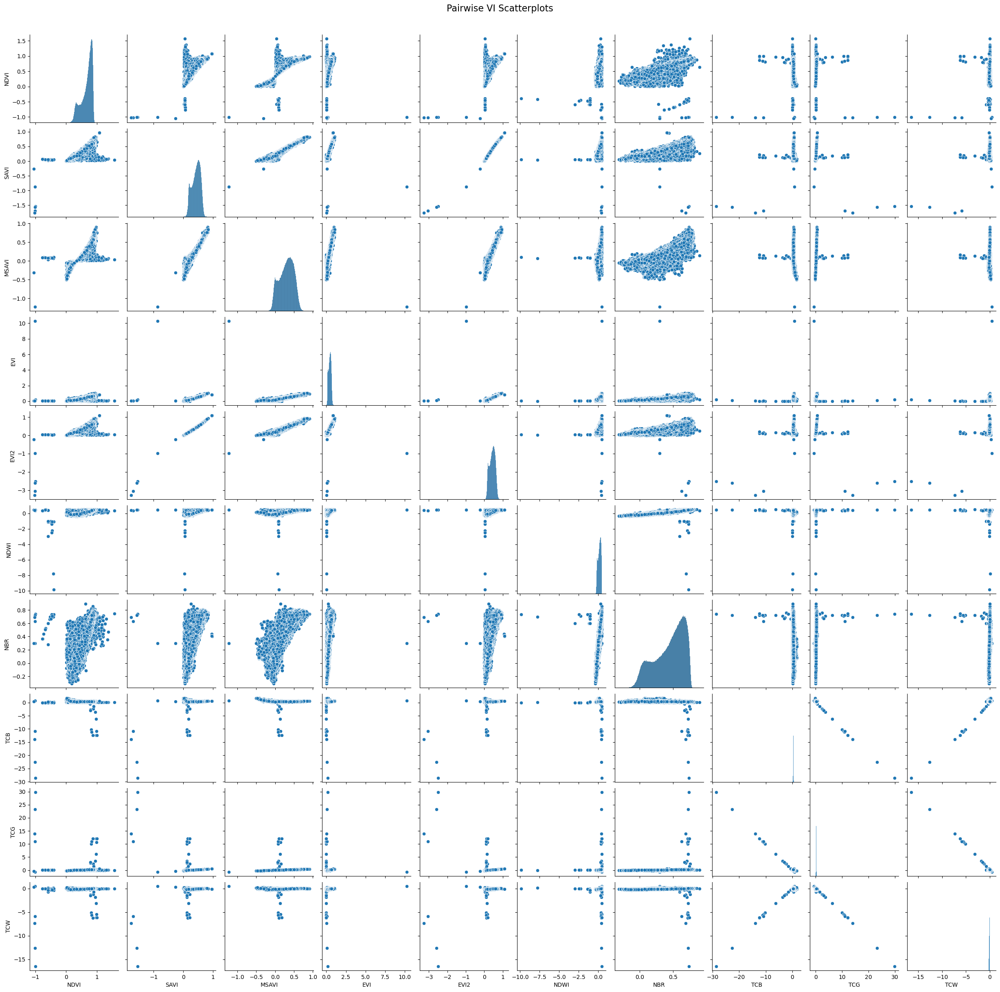

In [11]:
vi_pairplot = sns.pairplot(train_features.sample(frac=0.25))
vi_pairplot.fig.suptitle("Pairwise VI Scatterplots", fontsize=16)
vi_pairplot.fig.subplots_adjust(top=0.95)

In [13]:
vi_pairplot.fig.savefig('./img/feature_pairplots.png',dpi=200, bbox_inches='tight')

## Feature vs Target Plots

In [3]:

feature_cols = ['NDVI', 'SAVI', 'MSAVI', 'EVI','EVI2', 'NDWI', 'NBR', 'TCB', 'TCG', 'TCW']

target_cols = ['SrvvR_1', 'SrvvR_2', 'SrvvR_3', 'SrvvR_4','SrvvR_5', 'SrvvR_6', 'SrvvR_7']

drop_cols = ['ID', 'PixelID', 'Area_ha', 'Season', 'PlantDt', 'prevUse', 'Planted','SpcsCmp', 'Type',
            'NmbrPlO', 'NmbrPlR', 'NmbrPlT', 'ImgDate']

df_train = pd.read_parquet('./data/train_data.parquet',columns=feature_cols+target_cols)

Text(0.5, 0.98, 'Survival Rate vs VI Scatterplots')

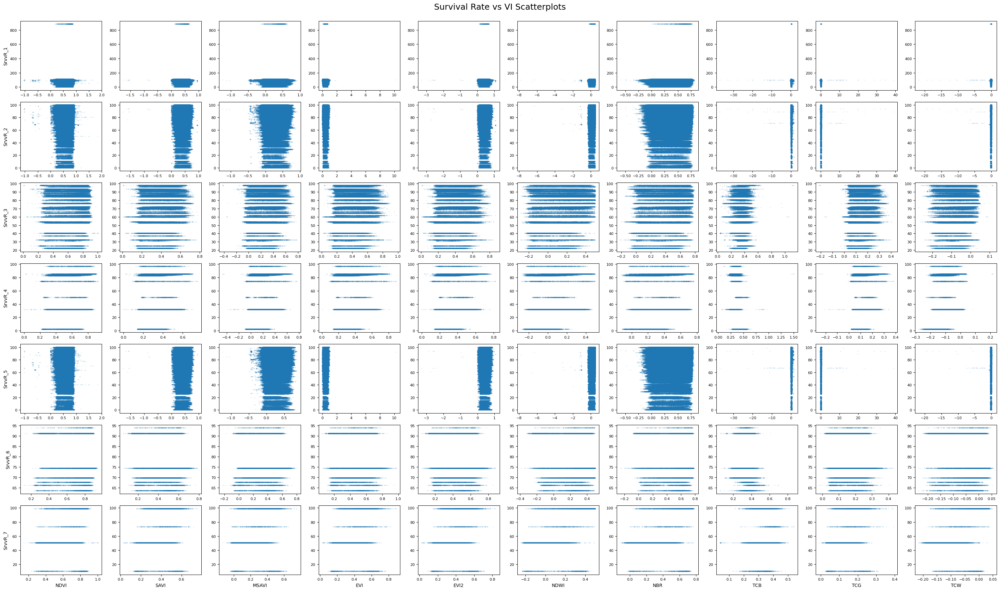

In [11]:
fig, axes = plt.subplots(nrows=7, ncols=10, figsize=(30, 18), sharex=False, sharey=False)
df_subsample = df_train.sample(frac=0.5)

# Plot each target (row) against each feature (column)
for i, target in enumerate(target_cols):
    for j, feature in enumerate(feature_cols):
        ax = axes[i, j]
        sns.scatterplot(data=df_subsample, x=feature, y=target, ax=ax, s=5, marker="+", alpha=0.5)
        if i == 6:
            ax.set_xlabel(feature, fontsize=10)
        else:
            ax.set_xlabel("")
        if j == 0:
            ax.set_ylabel(target, fontsize=10)
        else:
            ax.set_ylabel("")
        ax.tick_params(axis='both', labelsize=8)

plt.tight_layout()
plt.subplots_adjust(top=0.95)
fig.suptitle('Survival Rate vs VI Scatterplots',fontsize=18)

In [12]:
fig.savefig('./img/target_feature_scatterplots.png',dpi=200,bbox_inches='tight')

Notes for Pyotr:
 * Clarify the expected range of VI values, expecting to be between -1 and 1.
 * Missingness of survival rate records: 3rd,4th,6th,7th year have many missing values
 * Ask about categorical features: `SpcsCmp`, `prevUse`
 * Explain pivoting approach to convert survival columns to single target column with year feature
 * Ask about multicollinearity/mathematical similarity of vegetation indices, and possibility of removing some features
 * Ask why some survival rate records are above 100% (as large as 800%) (we should remove if simple errors).
 * Is burn ratio applicable and/or useful in this context, were there any sites that burned down in forest fires?
 * Is predictive power or interpretability (eg. feature importance) more important? 